# Practical Bioinformatics / Homework 6

1. Select a gene: I've decided to choose this one - **LMNA**

according to the human gene list: https://genomics.senescence.info/genes/allgenes.php.


2. Find amino acid sequences of genes for the following species (that are listed below) and create a fasta file with the sequences.

In this step, it is possible to do smth according to:
* orthologs databases (the list of db is located there - https://questfororthologs.org/orthology_databases);
* manual searching in NCBI databases;
* via blast;
* finding the gene on http://www.ensembl.org and view orthologs by clicking in the tab on the left side 'Gene-based displays-> ComparativeGenomics->Orthologues'.


The minimum list of species required for inclusion in the tree (if we can not find someone, then comment it and replace it according our choice):
- human
- monkey
- rodent
- ungulate
- marsupial
- amphibian
- reptile
- bird
- fish
- tree
- grass/flower
- fungus
- archaea
- bacterium.

I've decided to select the second (NCBI db searching by manually to find proten seqs) option and do all the steps as it is shown below.

Also, according to GeneCards the list of orthologs is illustrated:

https://www.genecards.org/cgi-bin/carddisp.pl?gene=LMNA#orthologs

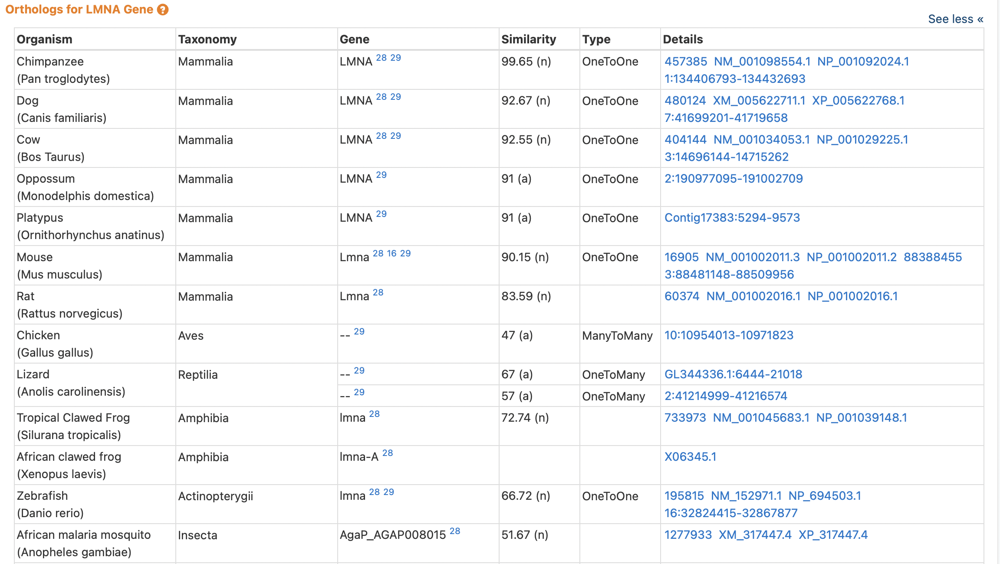

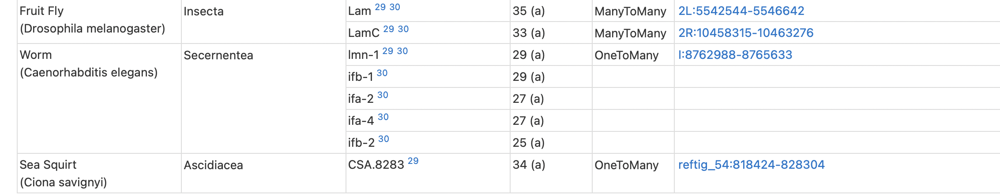

..or according to Ensembl:

after that, we may find out the protein seq of any species via NCBI based on the retrieved Ensembl inf.

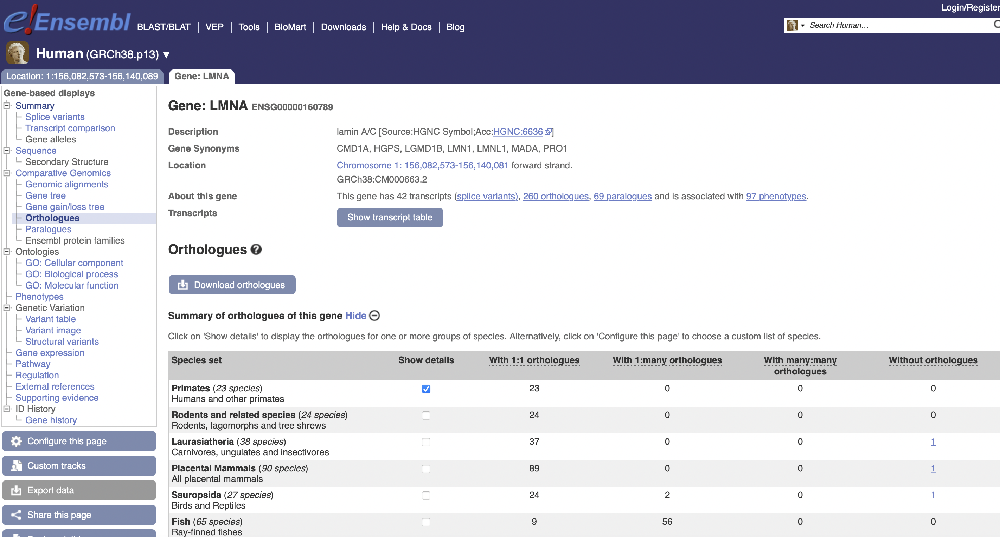

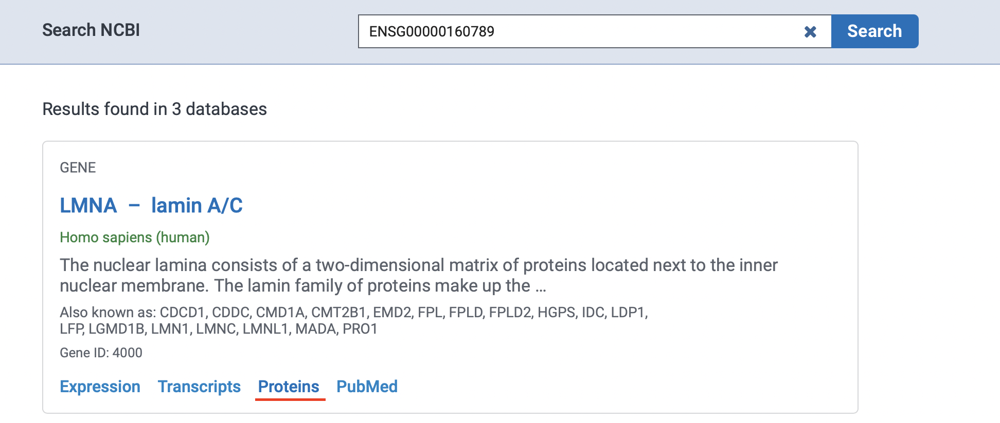

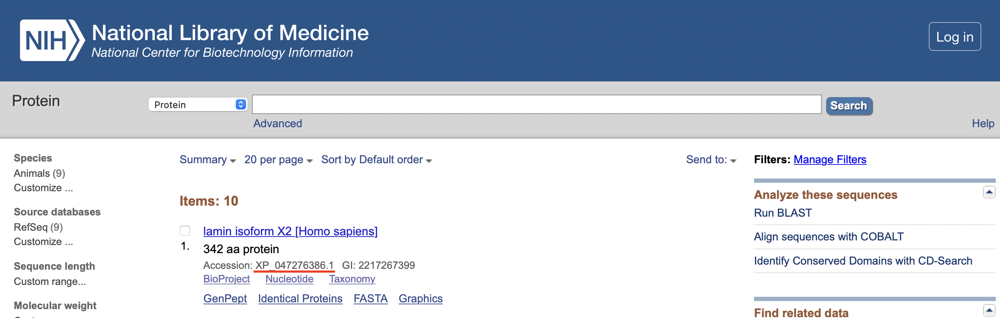

btw, Ensembl contains a huge list of orthologs, for instance (as a part of that for better representation):

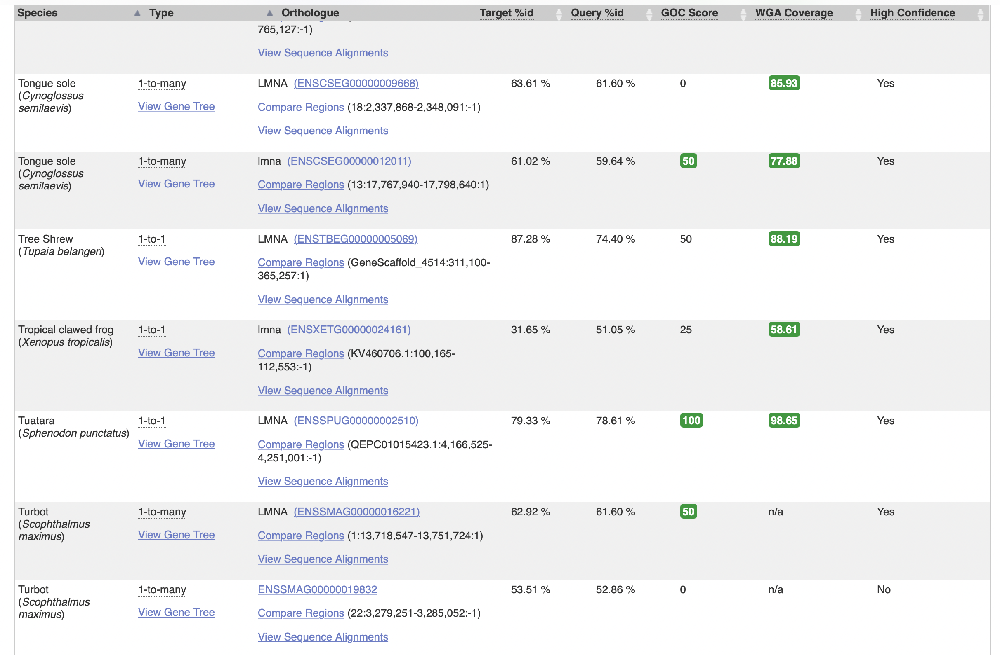

Let's select the following species taking into the account the list of required species for phylogenetic tree construction:
- human (homo sapiens)
- chimpanzee (pan troglodytes) / monkey
- mouse (mus musculus) / rodent
- cow (bos taurus) / ungulate
- oppossum (monodelphis domestica) / marsupial
- tropical clawed frog (xenopus tropicalis) / amphibian
- common wall lizard (podarcis muralis) / reptile
- collared flycatcher (ficedula albicollis) / bird
- atlantic salmon (salmo salar) / fish.

p.s. there are no findings related to: tree, grass/flowers/plants, fungus, archaea, bacterium.

*Download fasta protein seqs for the needed species.*

In [ ]:
pip install biopython

     |████████████████████████████████| 2.3 MB 8.2 MB/s 


In [ ]:
import os
from Bio import SeqIO, Entrez

Entrez.email = "mg217@example.com"

# unfortunately, for now I have no idea how to find Accession of a protein by primitive search like that
# "Lmna[All Fields] AND homo sapiens[All Fields]" or "lamin A/C {any species}" => I do it manually (because of the dif. ways of protein namings)
accession_list = ["XP_047276386.1","XP_016815406.1","XP_006501136.1","XP_005203678.1","XP_016285901.1",
                  "XP_031746375.1","XP_028565624.1","XP_005059085.1","XP_014056266.1"]  

fasta_path = "lmna.fasta"
fasta_file = open(fasta_path,"w")   

for accession in accession_list: 
  handle = Entrez.efetch(db="protein", id=accession, rettype="fasta")
  fasta_file.write(handle.read())
 # print(handle.read())
fasta_file.close()

In [ ]:
# delete empty lines in fasta file
with open("lmna.fasta", "r") as f:
  with open("lmna_proteins.fasta", "w") as w:
    for line in f:
        if line.strip():
            w.write(line)
            
!rm lmna.fasta

3. Do multiple sequence alignment using the Muscle algorithm (from Mega) and save this alignment.

MEGA (Molecular Evolutionary Genetics Analysis) can be installed via https://www.megasoftware.net/dload_mac_beta (for this type of os as an example).


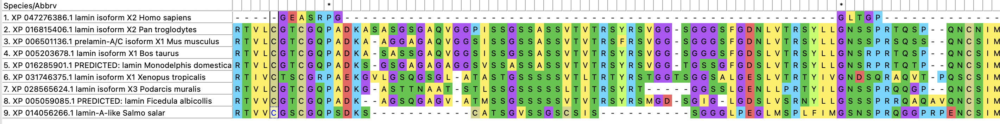

4. Construct several phylogenetic trees for amino acid sequences with bootstrap analysis by:
- neighbor-joining method
- maximum likelihood method

p.s. it can also be done by MEGA software

p.s.s https://kodomo.fbb.msu.ru/~agalicina/term4/3/index.html#3 more inf. about bootstrap

Bootstrop was chosen as = 100.

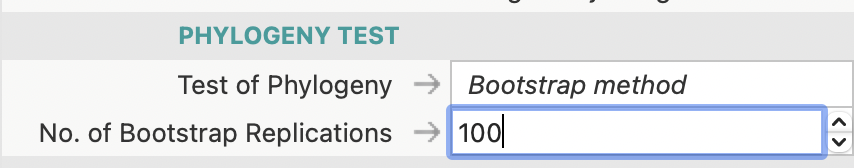

*Neighbor-Joining tree* (original tree) / substitution model - Poisson model

Substitution models of evolution describe the process of genetic variation through fixed mutations and constitute the basis of the evolutionary analysis at the molecular level. 

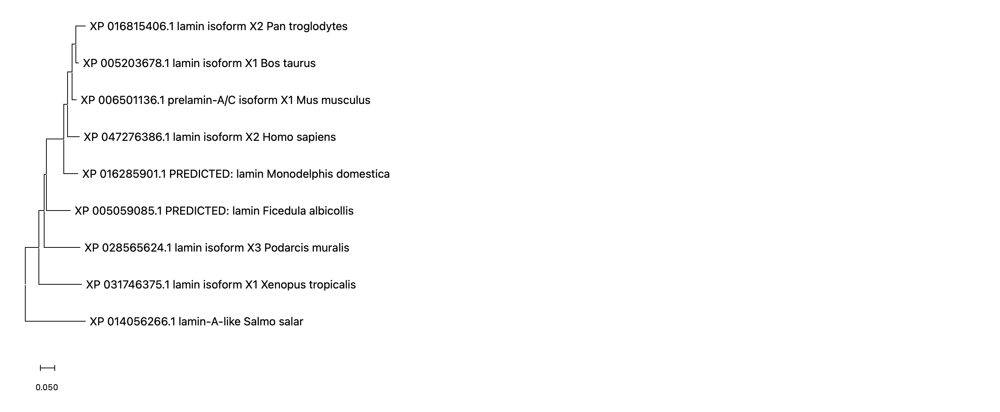

*Neighbor-Joining tree* (bootstrap tree) / substitution model - Poisson model

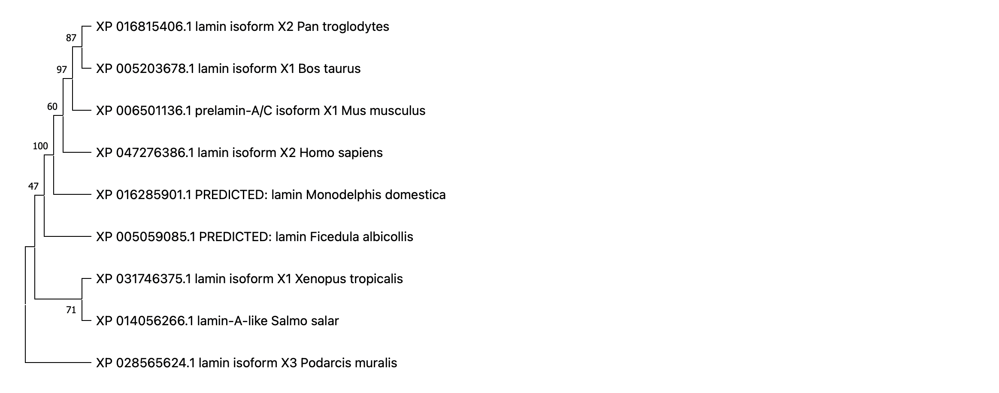

*Maximum Likelihood tree* (original tree) / substitution model - Jones-Taylor-Thornton (JTT) model

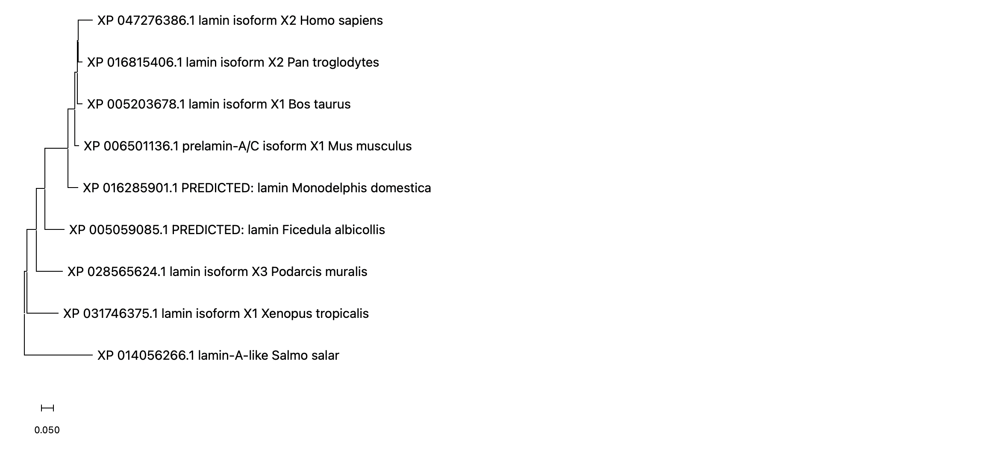

*Maximum Likelihood tree* (bootstrap tree) / substitution model: Jones-Taylor-Thornton (JTT) model

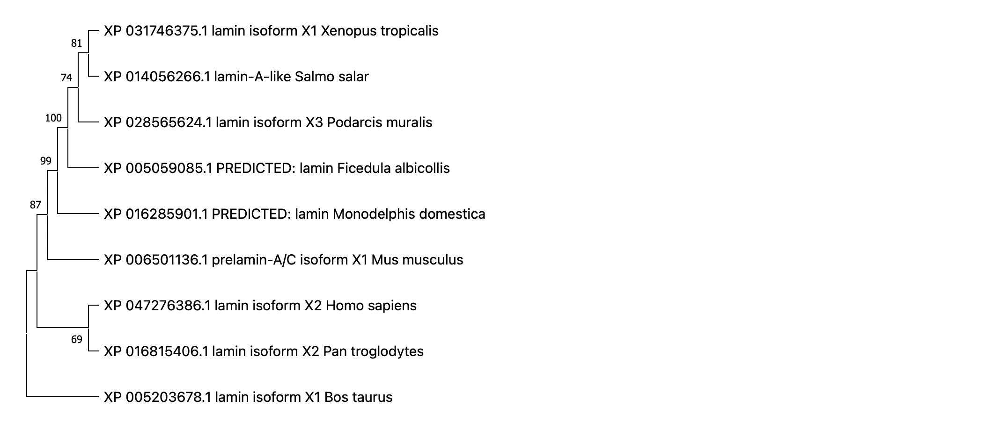

5. Results annotation

5.1-2 How much similarity is obtained for the resulting gene trees (for all of the 4 ones) according to the 'basic' tree of species? (to get the answer, we can use https://www.ncbi.nlm.nih.gov/taxonomy). If differences exist, describe them and suggest how they can be explained?

R: A phylogenetic tree is a diagram that represents evolutionary relationships among organisms. The pattern of branching in a phylogenetic tree reflects how species or other groups evolved from a series of common ancestors. In trees, two species are more related if they have a more recent common ancestor and less related if they have a less recent common ancestor.

An example of phylogenetic tree (in a primitive representation) is shown below.


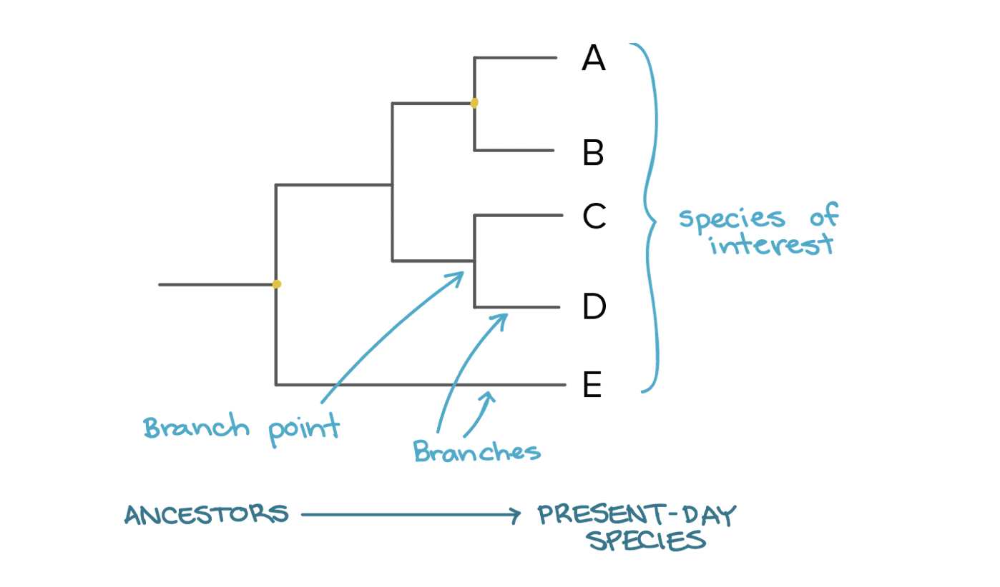

or better representation of phylogenetic tree for the animal kingdom:

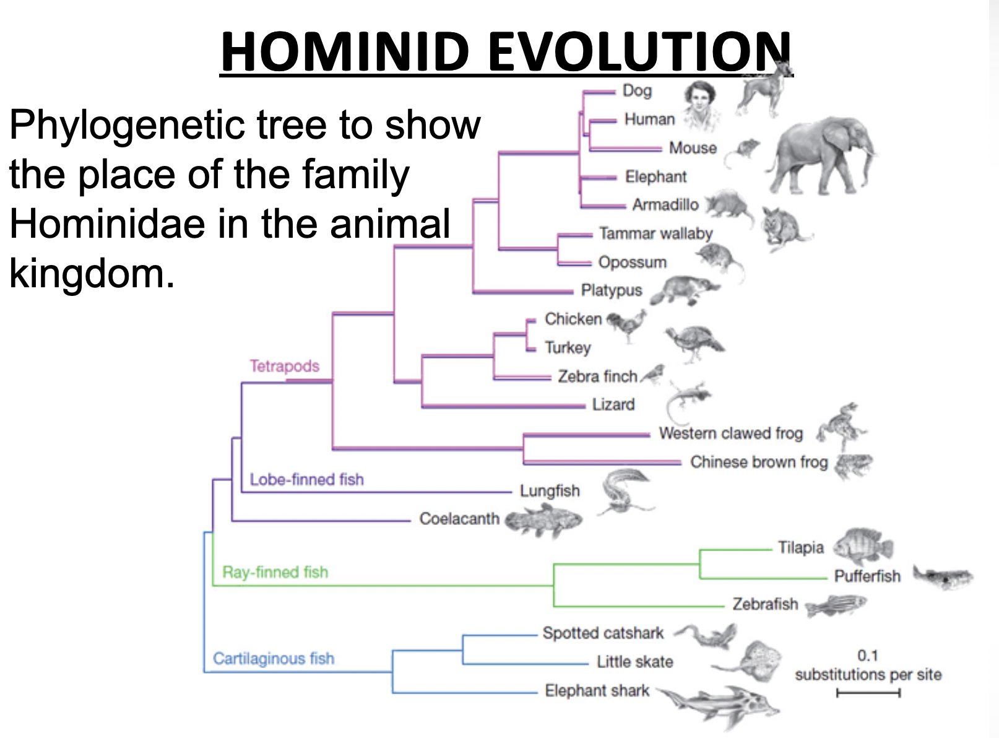

If we compare the obtained four phylogenetic trees with the sample tree above, we may conclude that 'the better' tree (in terms of similarity with 'basis' phylogenetic tree) was obtained by use of Maximum Likelihood (ML) method. It is worth to note, that all the 4 resulted trees have dif. structure and various combinations of organisms groups (even both ML/NJ original and ML/NJ bootstrap trees differ between each other).

In my opinion, the best resulted tree that was constructed is such one that was based on the ML bootstrap method; it can be proved by the picture which is shown below:

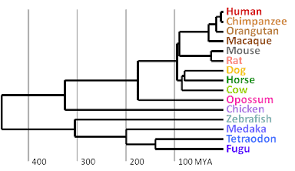

According to the resulted trees -> the methods comparison, NJ is faster in term of computing but quite weaker compare to ML. This is because ML uses more complex evolution model, so closer to the real life and the mathematics behind ML/bayesian methods are know to be stronger than NJ for reconstructing sequence histories.

In my opinion, at the first step of research analysis the NJ method is good choice for defining a good dataset or testing new one and then it is better go to ML to have a robust phylogeny for publishing.

5.3 What is the meaning of bootstrap values?

R: Bootstrap values in a phylogenetic tree indicate that out of 100, how many times the same branch is observed when repeating the generation of a phylogenetic tree on a resampled set of data. 

So, if we get this observation 100 times out of 100, then this supports our result; or if we recover the same node through 95 of 100 iterations of taking out one character and resampling of our tree, then we have a good idea that the node is well supported with a bootstrap value of 95%. Moreover, bootstrap values less than 50% are not taken into account for tree construction.

5.4 Use other parameters, for instance, to change the substitution model.

I've changed the substitution model into Dayhoff model:

In the Dayhoff approach, replacement rates are derived from alignments of protein sequences that are at least 85% identical; this constraint ensures that the likelihood of a particular mutation being the result of a set of successive mutations is low.

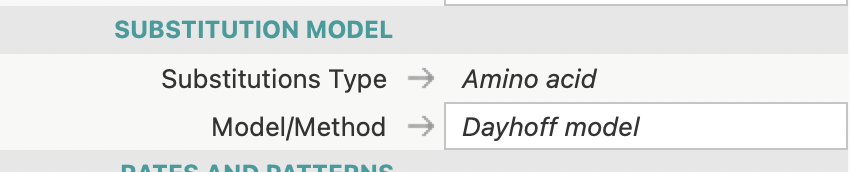

*Neighbor-Joining tree* (original tree) / Dayhoff model

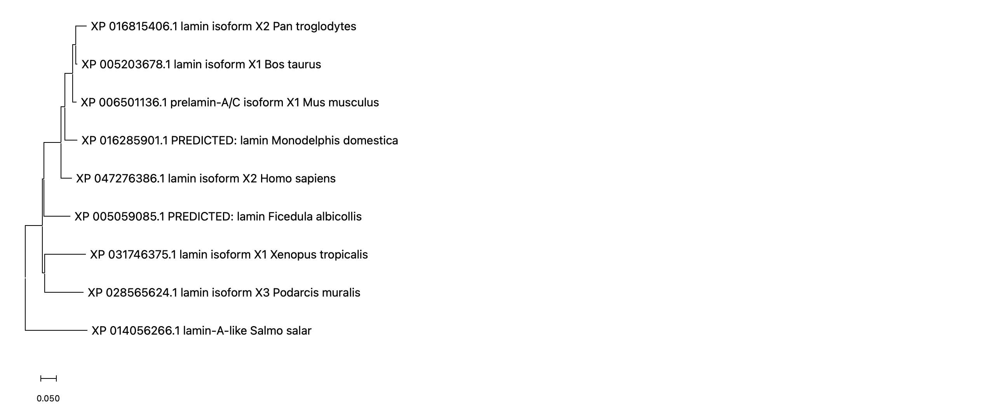

*Neighbor-Joining tree* (bootstrap tree) / Dayhoff model

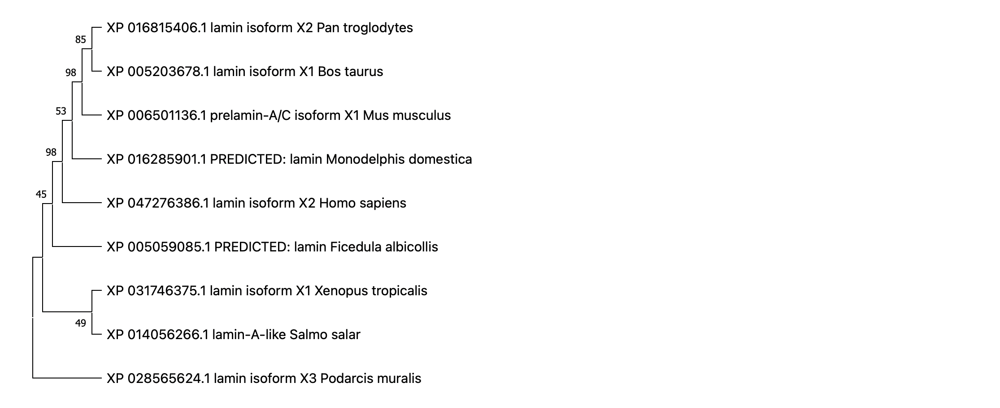

/ .. ML method for phylogenetic trees construction requires a lot of time #_# /

The results are little bit worse than the original ones (for instance, bootstrap values are lower than previous).

5.5 Construct phylogenetic trees using raxml and phyml.

raxml - https://raxml-ng.vital-it.ch/#/ 

phyml - http://www.atgc-montpellier.fr/phyml/

Description: Accession -> Species name:
1. XP_047276386.1 - human (homo sapiens)
2. XP_016815406.1 - chimpanzee (pan troglodytes)
3. XP_006501136.1 - mouse (mus musculus) 
4. XP_005203678.1 - cow (bos taurus)
5. XP_016285901.1 - oppossum (monodelphis domestica) 
6. XP_031746375.1 - tropical clawed frog (xenopus tropicalis)
7. XP_028565624.1 - common wall lizard (podarcis muralis)
8. XP_005059085.1 - collared flycatcher (ficedula albicollis) / bird
9. XP_014056266.1 - atlantic salmon (salmo salar)

*Phylogenetic tree (by raxml* with defaults for aa)

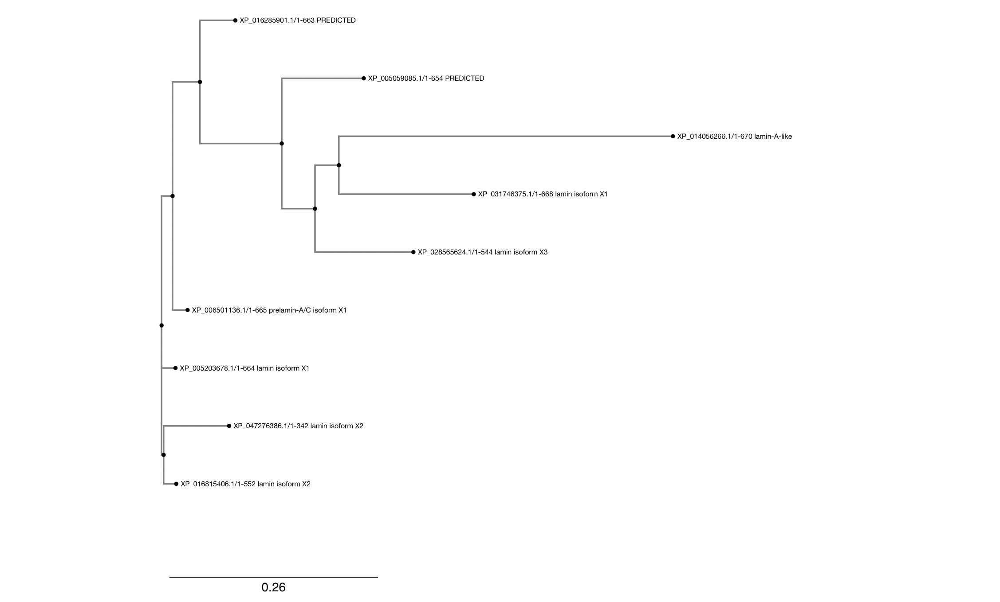

In [ ]:
# for phyml it is needed to convert aligned seqs (fasta -> phylip format)

records = SeqIO.parse("lmna_aligned.fasta", "fasta")
count = SeqIO.write(records, "lmna.phylip", "phylip")
print("Converted %i records" % count)

Converted 9 records


*Phylogenetic tree (by phyml* with defaults for aa)

/idk why the accession numbers were cutted off./

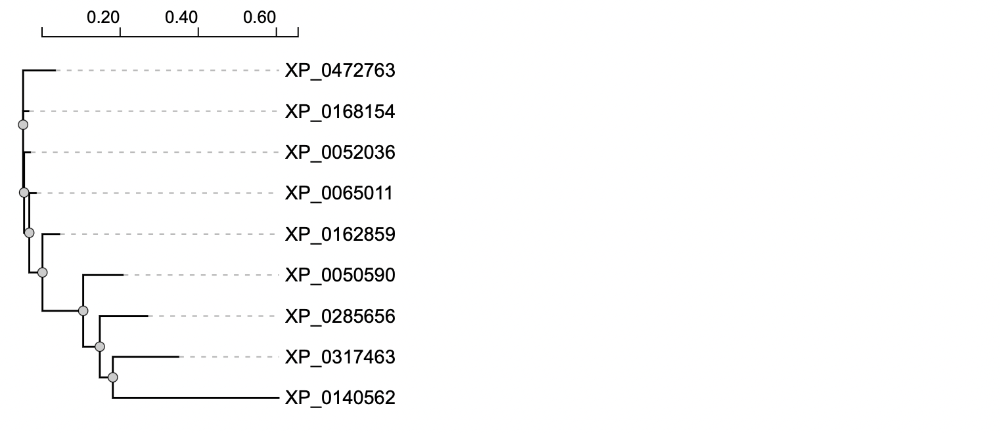

I've also used this web site to construct the phylogenetic tree (https://ngphylogeny.fr):

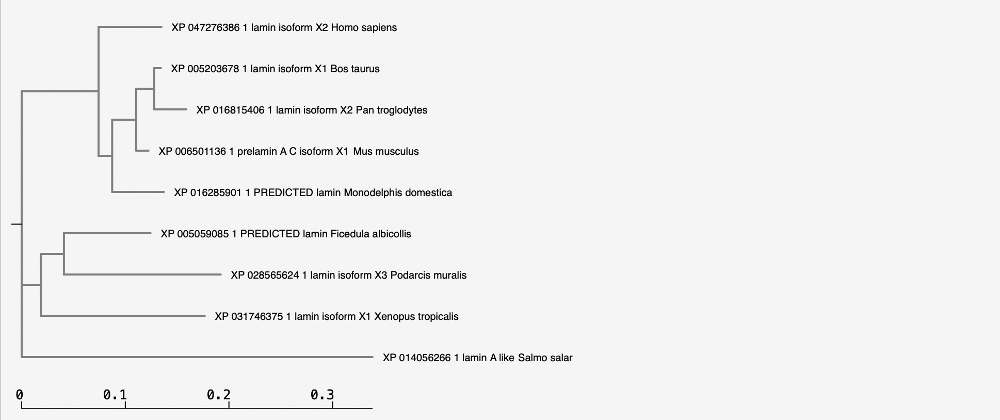

5.6 Build an alignment using MAFFT and do the same steps as in subsections 4-5.2, 5.4.


mafft can be download from the website: https://mafft.cbrc.jp/alignment/software/

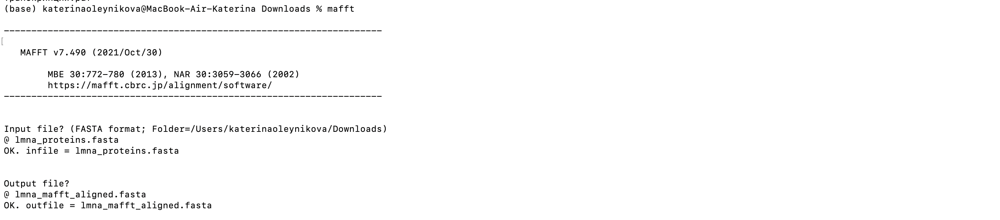

*Neighbor-Joining tree* (original tree) / substitution model - Poisson model; for mafft aligned sequences:

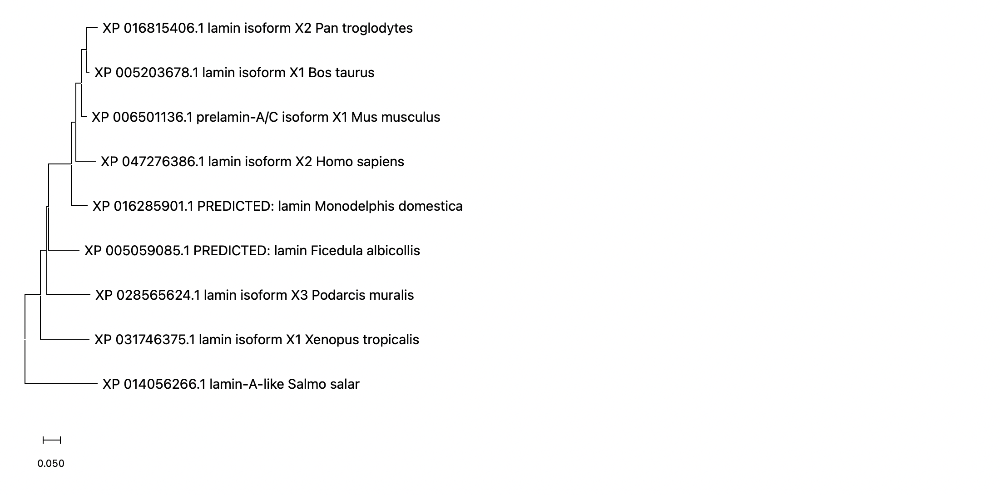

*Neighbor-Joining tree* (bootstrap tree)  / substitution model - Poisson model; for mafft aligned sequences:

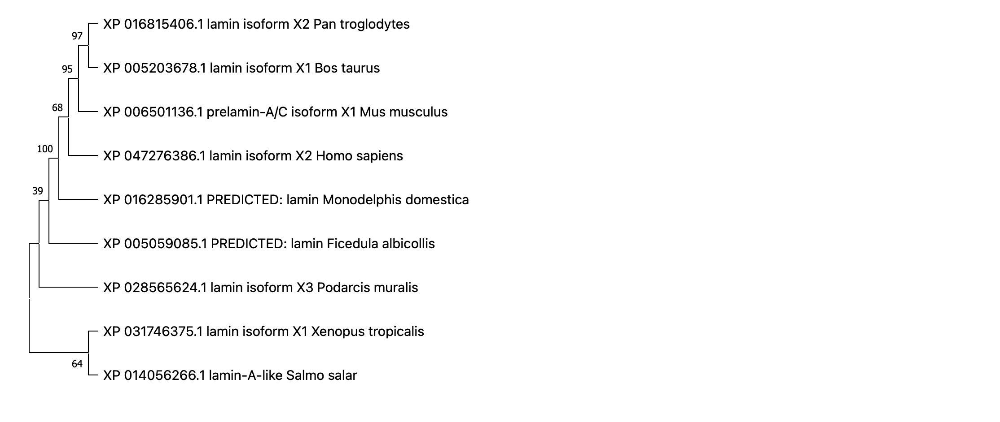

/ .. ML method for phylogenetic trees construction requires a lot of time *^-^* /

if we compare the resulted trees with the previous trees obtained by the same method, we may see the bootstrap values difference (the current values are a little bit lower than the original ones), i.e., the first way is better than this one (which is based on mafft aligned sequences).

*Neighbor-Joining tree* (original tree) / Dayhoff model (for mafft aligned sequences)

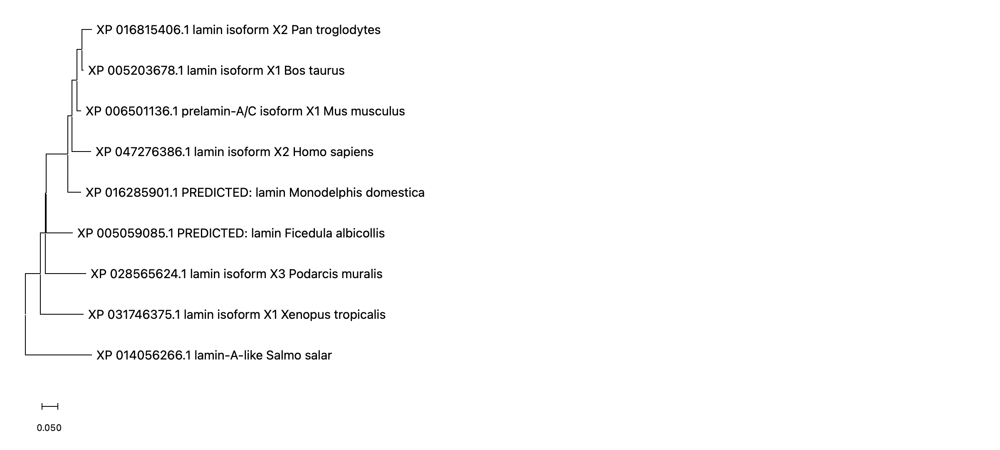

*Neighbor-Joining tree* (bootstrap tree) / Dayhoff model (for mafft aligned sequences)

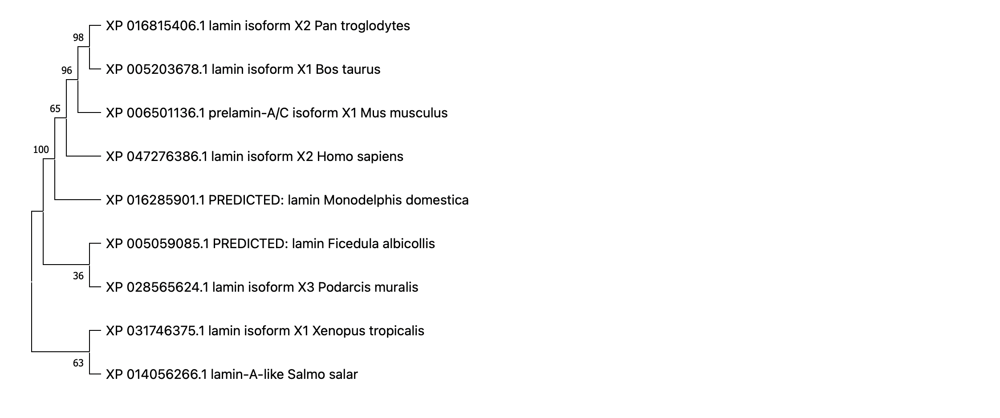

/ .. ML method for phylogenetic trees construction requires a lot of time, too #_# /

If we compare the latter results (Poisson model and Dayhoff model), we see the main dif. in the bootstrap values, too: some of the bootstrap values are better for Poisson model, while another part of values is better for Dayhoff model.

the general view (relative location for each species) is the same as for the original phylogenetic trees (meens NJ method according to the MUSCLE aligned sequences).